<a href="https://colab.research.google.com/github/OritPa/ML_TripAdvisor_Pipeline/blob/main/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
!pip install autoviz --quiet

In [4]:
import warnings
warnings.filterwarnings("ignore")
import pickle
import numpy as np
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from scipy.stats import chi2_contingency
from statsmodels.stats.proportion import proportions_ztest
from statsmodels.stats.multitest import multipletests
from matplotlib.ticker import PercentFormatter, FuncFormatter, LogLocator, LogFormatter
from autoviz.AutoViz_Class import AutoViz_Class

Imported v0.1.905. Please call AutoViz in this sequence:
    AV = AutoViz_Class()
    %matplotlib inline
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [5]:
with open("df_main.pkl", "rb") as f:
    df_raw = pickle.load(f)

df = df_raw.copy()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 224763 entries, 0 to 224762
Data columns (total 63 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   restaurant_link                    224763 non-null  string 
 1   restaurant_name                    224763 non-null  string 
 2   region                             224763 non-null  string 
 3   province                           224763 non-null  string 
 4   city                               224763 non-null  string 
 5   address                            224763 non-null  string 
 6   latitude                           222603 non-null  float64
 7   longitude                          222603 non-null  float64
 8   claimed                            224763 non-null  int64  
 9   awards                             224763 non-null  int64  
 10  popularity_detailed                208339 non-null  string 
 11  popularity_generic                 2074

###Helpers

In [6]:
def nice_label(s: str) -> str:
    """Make column names human-readable in plots."""
    return (s.replace("_per_", " per ")
             .replace("__", " ")
             .replace("_", " "))

In [7]:
def bin_series_safe(s: pd.Series, q: int = 5):
    """qcut with fallback to cut, robust to duplicate edges."""
    try:
        return pd.qcut(s, q=q, duplicates="drop")
    except Exception:
        return pd.cut(s, bins=q)

In [8]:
def finalize_axes(ax=None, *, title=None, xlabel=None, ylabel=None, xrot=0, tight=True):
    ax = ax or plt.gca()
    if title: ax.set_title(title, fontsize=12, pad=10)
    if xlabel: ax.set_xlabel(xlabel)
    if ylabel: ax.set_ylabel(ylabel)
    if xrot:
        for lbl in ax.get_xticklabels():
            lbl.set_rotation(xrot)
            lbl.set_ha("right")
    ax.grid(alpha=0.25)
    if tight: plt.tight_layout()
    return ax

###DATA PROTOCOL

In [9]:
with pd.ExcelWriter("summary.xlsx") as xw:
    df.dtypes.astype(str).rename("dtype").to_excel(xw, sheet_name="data_type")
    df.max(numeric_only=True).to_excel(xw, sheet_name="max_numeric")
    df.min(numeric_only=True).to_excel(xw, sheet_name="min_numeric")
    df.isnull().sum().rename("missing").to_excel(xw, sheet_name="missing")
    df.nunique().rename("unique").to_excel(xw, sheet_name="unique")

    Since nrows is smaller than dataset, loading random sample of 150000 rows into pandas...
Shape of your Data Set loaded: (150000, 63)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
restaurant_link of type=string is not classified
restaurant_name of type=string is not classified
region of type=string is not classified
province of type=string is not classified
city of type=string is not classified
address of type=string is not classified
popularity_detailed of type=string is not classified
popularity_generic of type=string is not classified
price_range of type=string is not classified
special_diets of type=string is not classified
default_language of type=string is not classified
    Number of Numeric Columns =  18
    Number of Intege

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
restaurant_link,string,0.000000,100,,,No issue
restaurant_name,string,0.000000,85,,,No issue
region,string,0.000000,0,,,No issue
province,string,0.000000,0,,,No issue
city,string,0.000000,0,,,No issue
address,string,0.000000,97,,,No issue
latitude,float64,0.976000,NA,35.128260,47.072758,"1464 missing values. Impute them with mean, median, mode, or a constant value such as 123."
longitude,float64,0.976000,NA,3.715689,33.369423,"1464 missing values. Impute them with mean, median, mode, or a constant value such as 123., Column has 100 outliers greater than upper bound (19.74) or lower than lower bound(3.60). Cap them or remove them."
claimed,int64,0.000000,0,0.000000,1.000000,No issue
awards,int64,0.000000,0,0.000000,1.000000,No issue


Number of All Scatter Plots = 171


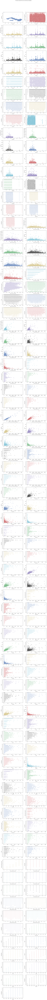

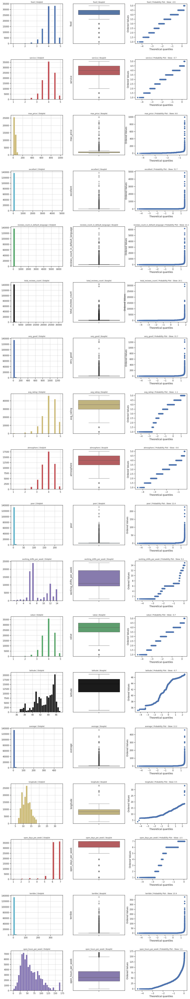

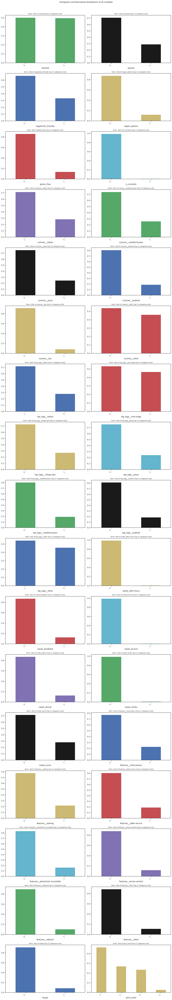

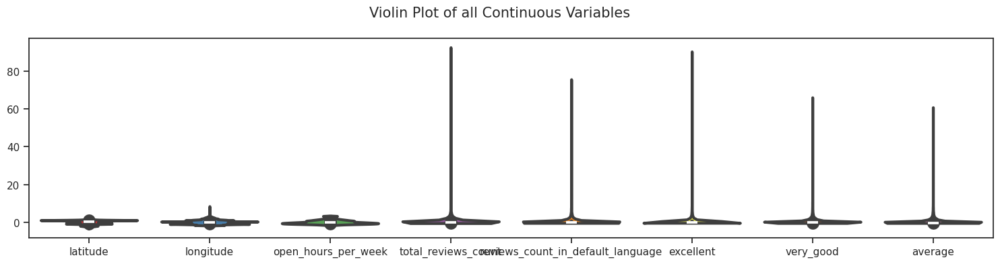

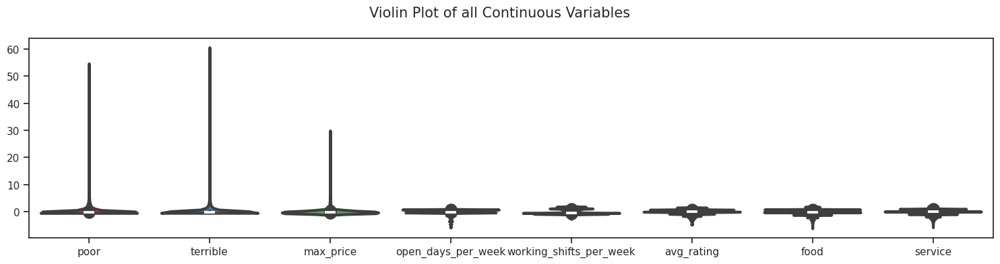

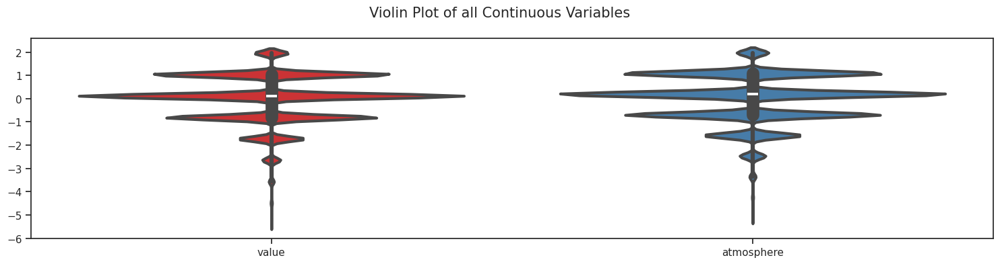

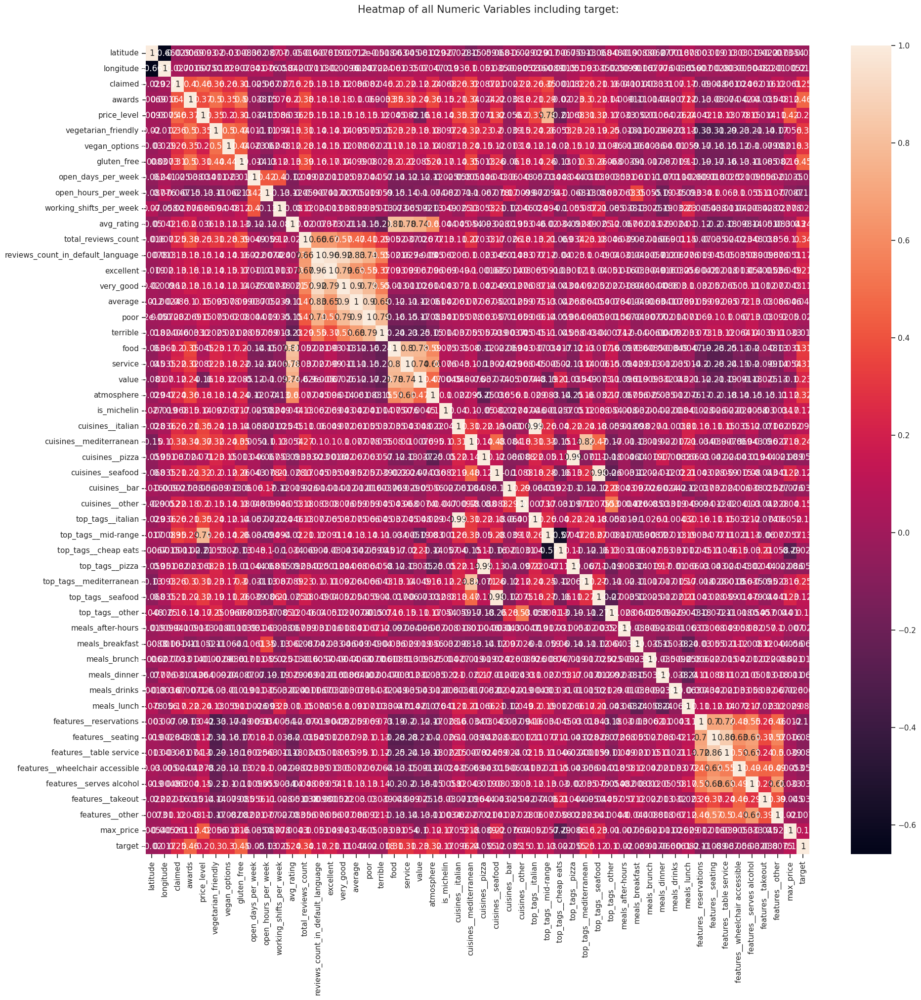

All Plots done
Time to run AutoViz = 245 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [10]:
AV = AutoViz_Class()
%matplotlib inline
_ = AV.AutoViz(filename="", dfte=df)


###Suspected correlated columns (ratings & experience)

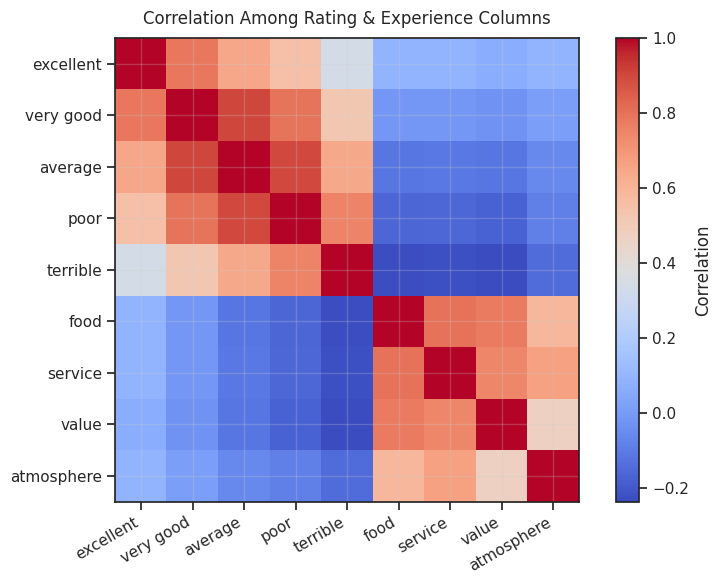

In [14]:
rating_cols = ["excellent", "very_good", "average", "poor", "terrible"]
exp_cols    = ["food", "service", "value", "atmosphere"]
corr_cols   = rating_cols + exp_cols

corr_mat = df[corr_cols].corr()
plt.figure(figsize=(8, 6))
plt.imshow(corr_mat, cmap="coolwarm", interpolation="nearest")
plt.xticks(range(len(corr_cols)), [nice_label(c) for c in corr_cols], rotation=30, ha="right")
plt.yticks(range(len(corr_cols)), [nice_label(c) for c in corr_cols])
plt.colorbar(label="Correlation")
finalize_axes(title="Correlation Among Rating & Experience Columns")
plt.show()

<Figure size 600x400 with 0 Axes>

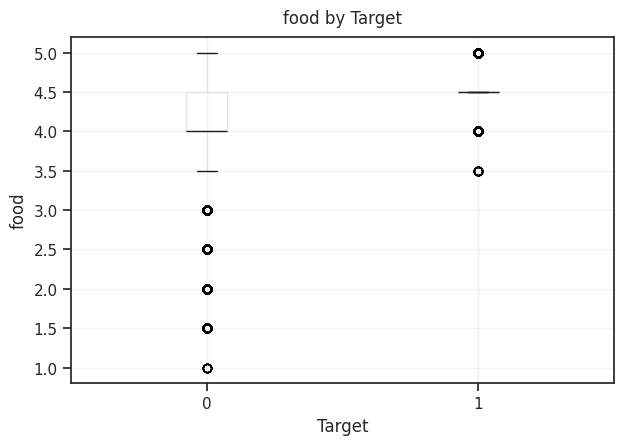

<Figure size 600x400 with 0 Axes>

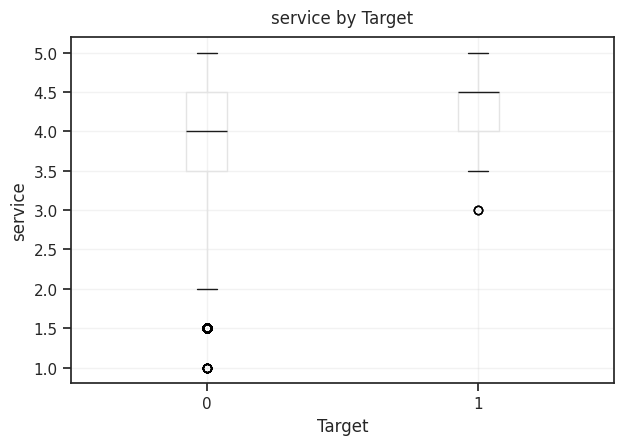

<Figure size 600x400 with 0 Axes>

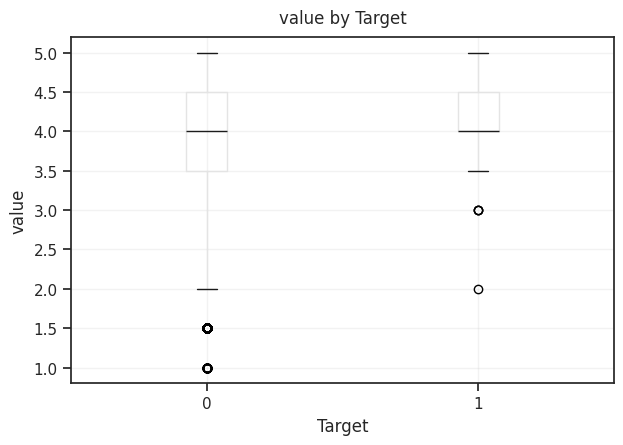

<Figure size 600x400 with 0 Axes>

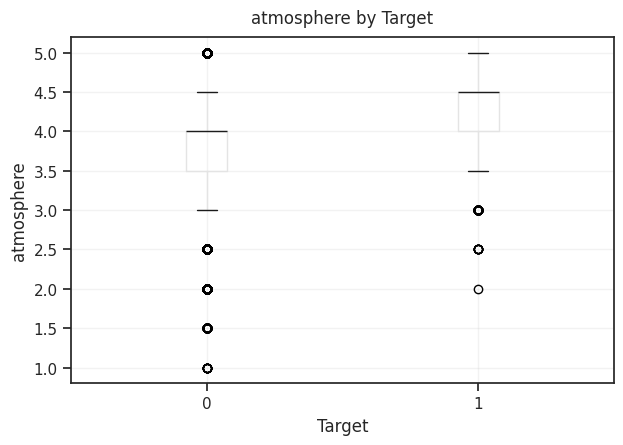

In [15]:
# Boxplots vs target (experience cols)
for col in exp_cols:
    plt.figure(figsize=(6, 4))
    df.boxplot(column=col, by="target", grid=False)
    plt.suptitle("")
    finalize_axes(title=f"{nice_label(col)} by Target", xlabel="Target", ylabel=nice_label(col))
    plt.show()

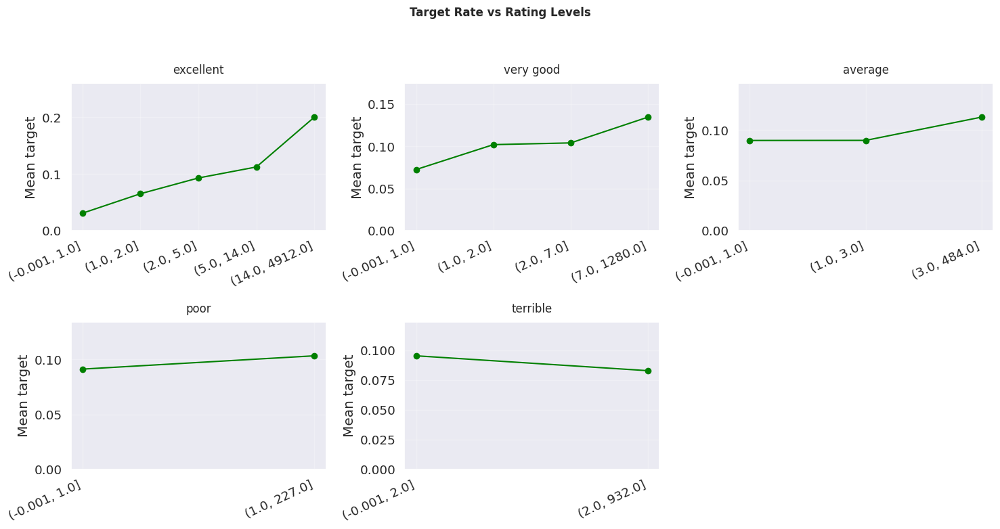

In [40]:
# Target rate vs rating levels (monotonic patterns)
n_cols = 3  # number of columns in grid
n_rows = (len(rating_cols) + n_cols - 1) // n_cols  # auto calc rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 4 * n_rows))  # taller plots

axes = axes.flatten()  # flatten axes for easy iteration
fig.suptitle("Target Rate vs Rating Levels", fontsize=12, fontweight="bold")

for ax, col in zip(axes, rating_cols):
    bins = bin_series_safe(df[col], q=5)
    grp = df.groupby(bins, observed=True)["target"].mean()
    ax.plot(range(len(grp)), grp.values, marker="o", color="green")
    ax.set_xticks(range(len(grp)))
    ax.set_xticklabels([str(b) for b in grp.index], rotation=25, ha="right")

    # Set y-axis limits to give more space (taller look)
    ax.set_ylim(0, max(grp.values) * 1.3)

    finalize_axes(ax, title=nice_label(col), ylabel="Mean target", tight=False)

# Hide any empty subplots
for i in range(len(rating_cols), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


These columns have strong or redundant relationships with the target, which risks data leakage. That’s why they should be excluded before modeling

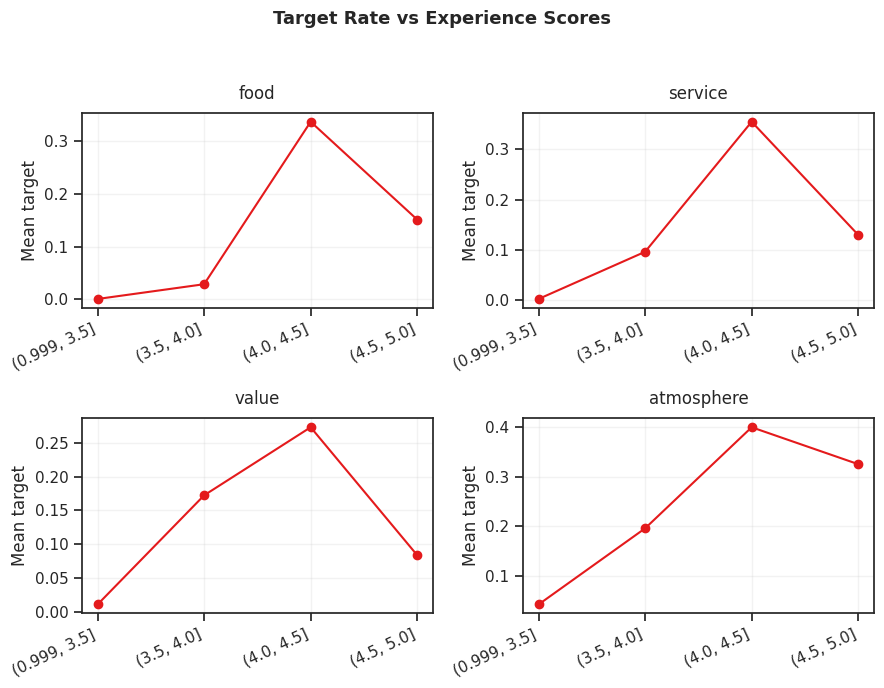

In [17]:
# Target rate vs experience scores (2x2)
fig, axes = plt.subplots(2, 2, figsize=(9, 7))
fig.suptitle("Target Rate vs Experience Scores", fontsize=13, fontweight="bold")
for ax, col in zip(axes.ravel(), exp_cols):
    bins = bin_series_safe(df[col], q=5)
    grp = df.groupby(bins, observed=True)["target"].mean()
    ax.plot(range(len(grp)), grp.values, marker="o")
    ax.set_xticks(range(len(grp)))
    ax.set_xticklabels([str(b) for b in grp.index], rotation=25, ha="right")
    finalize_axes(ax, title=nice_label(col), ylabel="Mean target", tight=False)
# hide remaining axes if any
for k in range(len(exp_cols), len(axes.ravel())):
    axes.ravel()[k].axis("off")
plt.tight_layout(rect=[0, 0, 1, 0.95])

Conclusion: They Predict Target Too Well

During exploratory data analysis, I examined how the experience-based features (food, service, value, and atmosphere) relate to the binary target variable. The “Target Rate vs Experience Scores” plots showed a clear, almost monotonic increase in the probability of target = 1 as each of these scores rose. For example, businesses with higher food or service ratings were far more likely to be classified as successful (target = 1), while those with lower ratings rarely reached that category.

This pattern closely mirrors how the target itself was defined—based on high average ratings and review counts. Because these features strongly overlap with the target’s logic, they don’t provide new information; instead, they duplicate or leak the same signal already embedded in the target definition.

Therefore, to avoid data leakage and ensure that the model learns from independent predictors, I will exclude the following columns from training

###Categorical overview for selected low-cardinality columns

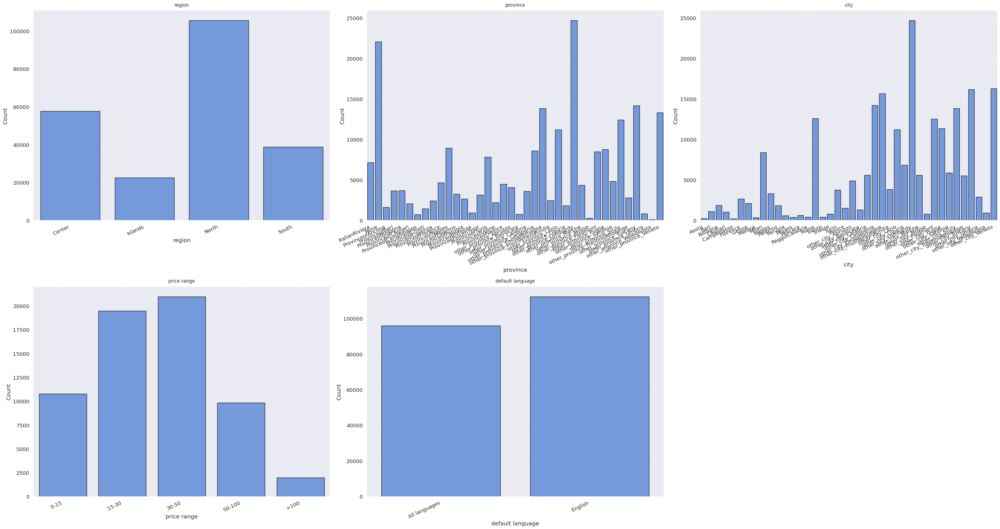

In [18]:
cat_cols = ["region", "province", "city", "price_range", "default_language"]
df_cat = df[cat_cols].astype("category")

n_rows, n_cols = 3, 3
plot_idx = 1
fig = plt.figure(figsize=(36, 28))
plt.subplots_adjust(hspace=0.7)
sns.set(font_scale=1.2)
for col in df_cat.columns:
    plt.subplot(n_rows, n_cols, plot_idx)
    sns.countplot(x=df_cat[col], color="cornflowerblue", edgecolor="black")
    finalize_axes(title=nice_label(col), xlabel=nice_label(col), ylabel="Count", xrot=25, tight=False)
    plot_idx += 1
plt.tight_layout()
plt.show()

Numeric subset + distributions

array([[<Axes: title={'center': 'claimed'}>,
        <Axes: title={'center': 'awards'}>,
        <Axes: title={'center': 'price_level'}>,
        <Axes: title={'center': 'vegetarian_friendly'}>,
        <Axes: title={'center': 'vegan_options'}>,
        <Axes: title={'center': 'gluten_free'}>,
        <Axes: title={'center': 'open_days_per_week'}>],
       [<Axes: title={'center': 'open_hours_per_week'}>,
        <Axes: title={'center': 'working_shifts_per_week'}>,
        <Axes: title={'center': 'avg_rating'}>,
        <Axes: title={'center': 'total_reviews_count'}>,
        <Axes: title={'center': 'reviews_count_in_default_language'}>,
        <Axes: title={'center': 'excellent'}>,
        <Axes: title={'center': 'very_good'}>],
       [<Axes: title={'center': 'average'}>,
        <Axes: title={'center': 'poor'}>,
        <Axes: title={'center': 'terrible'}>,
        <Axes: title={'center': 'food'}>,
        <Axes: title={'center': 'service'}>,
        <Axes: title={'center': 'value'

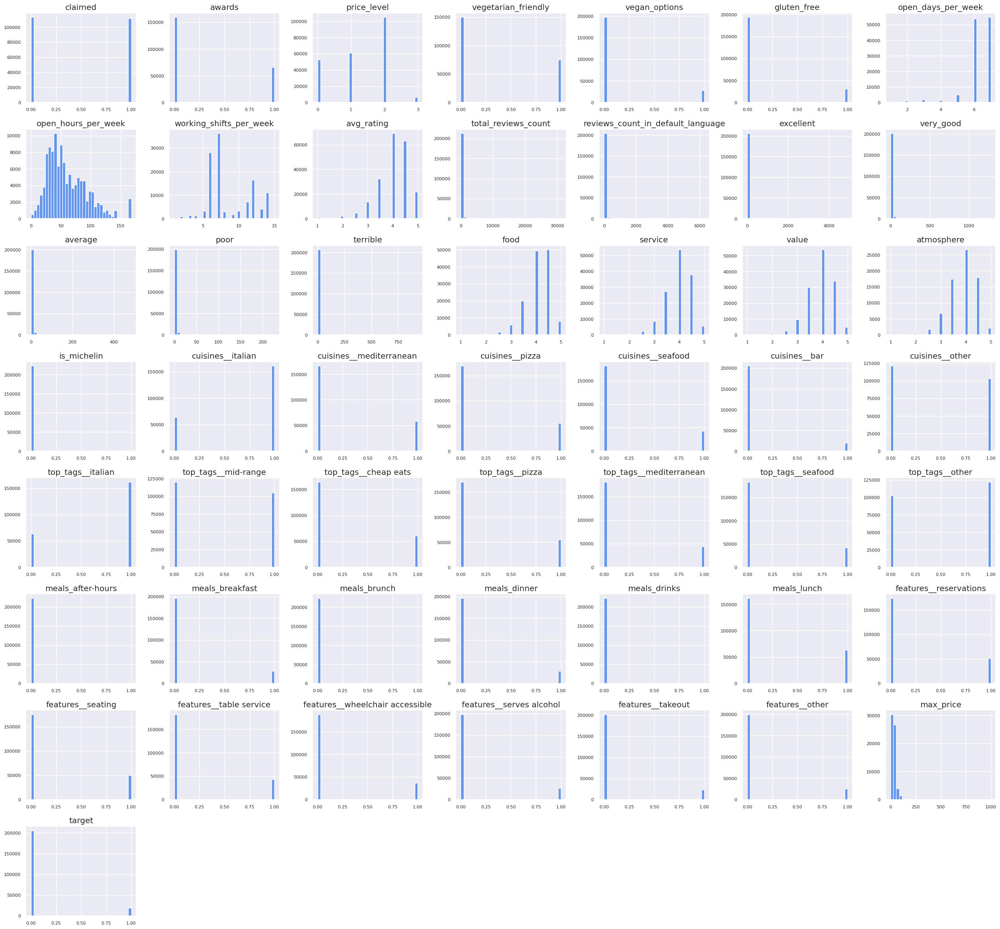

In [19]:
df_num = df.select_dtypes(include=["number"]).drop(columns=["latitude", "longitude"], errors="ignore")
df_num.hist(figsize=(28, 28), bins=35, xlabelsize=8, ylabelsize=8, color="cornflowerblue")

###Missingness

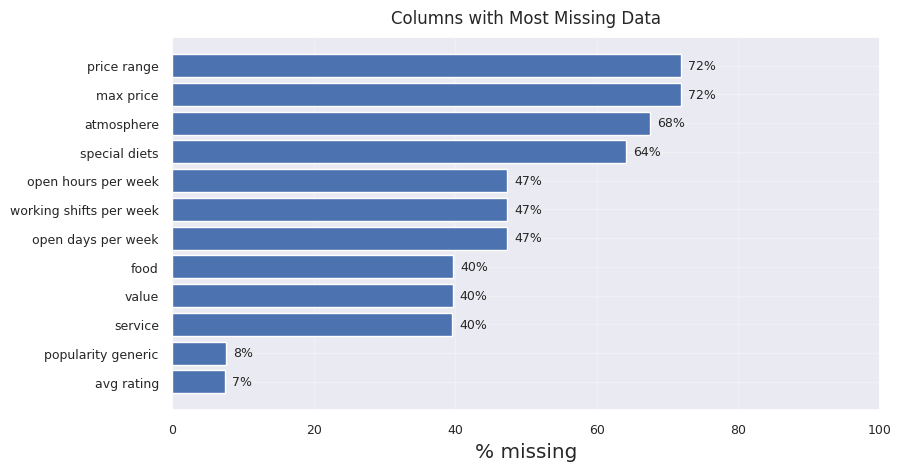

In [20]:
def plot_missingness(data: pd.DataFrame, *, topn: int = 12):
    miss = (data.isna().mean() * 100).sort_values(ascending=False)
    top = miss.head(topn).sort_values()
    labels = [nice_label(c) for c in top.index]
    values = top.values

    fig, ax = plt.subplots(figsize=(10, 5))
    y = np.arange(len(values))
    ax.barh(y, values)
    ax.set_yticks(y)
    ax.set_yticklabels(labels)
    ax.set_xlim(0, 100)
    finalize_axes(ax, title="Columns with Most Missing Data", xlabel="% missing", ylabel="")
    ax.tick_params(axis="both", labelsize=9)
    ax.margins(x=0.05)
    for yi, v in zip(y, values):
        ax.annotate(f"{v:.0f}%", xy=(v, yi), xytext=(5, 0),
                    textcoords="offset points", va="center", ha="left", fontsize=9)

plot_missingness(df, topn=12)
plt.show()

###Top 15 cities by mean review count

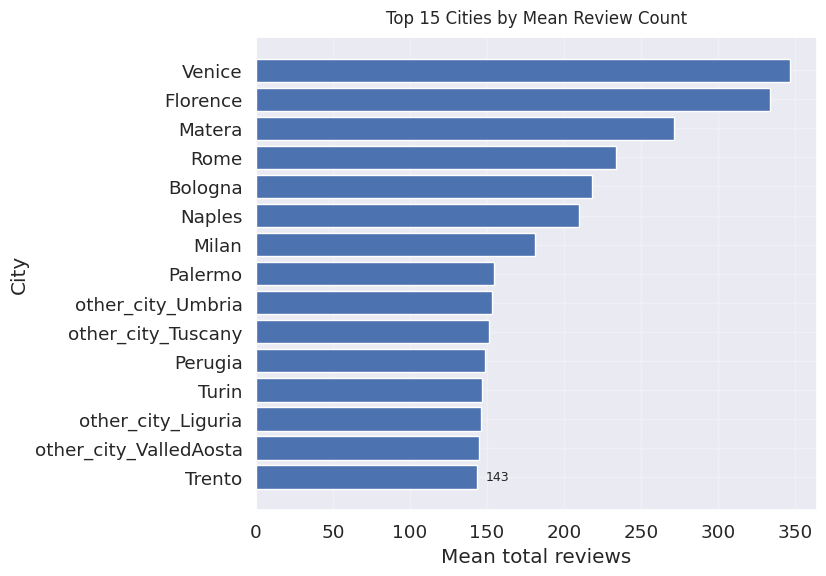

In [21]:
topn = 15
s_city = (
    df.groupby("city")["total_reviews_count"]
      .mean()
      .nlargest(topn)
      .sort_values()
)
fig, ax = plt.subplots(figsize=(8.5, 6))
bars = ax.barh(s_city.index, s_city.values)
ax.xaxis.set_major_formatter(FuncFormatter(lambda x, pos: f"{int(x):,}"))
finalize_axes(ax, title="Top 15 Cities by Mean Review Count", xlabel="Mean total reviews", ylabel="City")
for b in bars:
    ax.annotate(f"{int(b.get_width()):,}",
                xy=(b.get_width(), b.get_y() + b.get_height()/2),
                xytext=(6, 0), textcoords="offset points",
                va="center", ha="left", fontsize=9)
    plt.show()


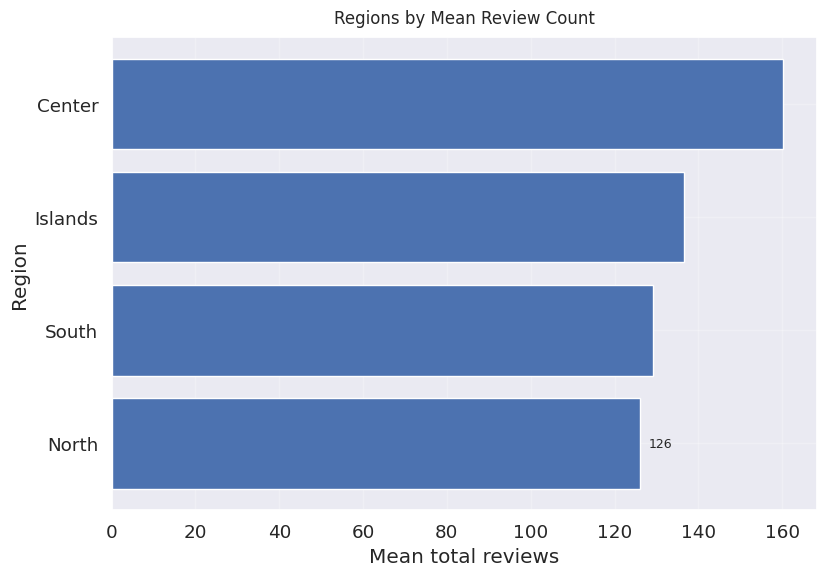

In [22]:
s_region = (
    df.groupby("region")["total_reviews_count"]
      .mean()
      .nlargest(topn)
      .sort_values()
)
fig, ax = plt.subplots(figsize=(8.5, 6))
bars = ax.barh(s_region.index, s_region.values)
ax.xaxis.set_major_formatter(FuncFormatter(lambda x, pos: f"{int(x):,}"))
finalize_axes(ax, title="Regions by Mean Review Count", xlabel="Mean total reviews", ylabel="Region")
for b in bars:
    ax.annotate(f"{int(b.get_width()):,}",
                xy=(b.get_width(), b.get_y() + b.get_height()/2),
                xytext=(6, 0), textcoords="offset points",
                va="center", ha="left", fontsize=9)
    plt.show()

###Cuisine to average target rate

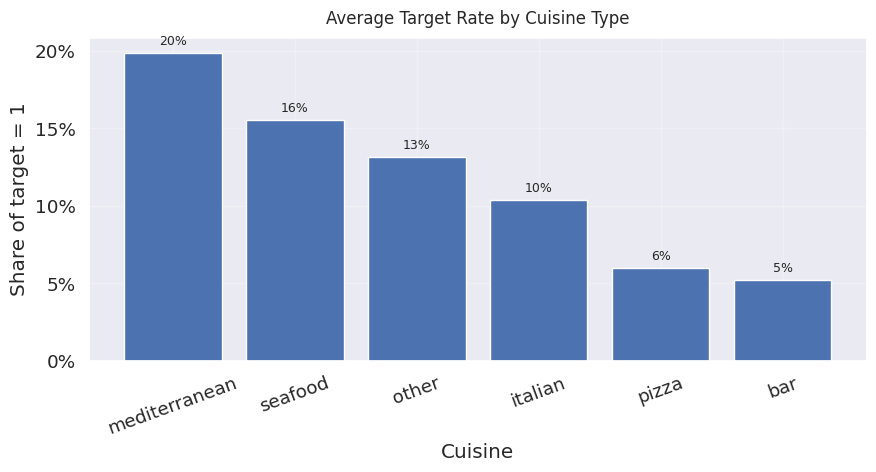

In [23]:
cuisine_cols = [c for c in df.columns if c.startswith("cuisines__")]
rates = {col: df.loc[df[col] == 1, "target"].mean() for col in cuisine_cols}
s_cui = pd.Series(rates).dropna().sort_values(ascending=False).head(10)
xlabels = [c.replace("cuisines__", "").replace("_", " ") for c in s_cui.index]

fig, ax = plt.subplots(figsize=(9, 4.5))
bars = ax.bar(xlabels, s_cui.values)
ax.yaxis.set_major_formatter(PercentFormatter(xmax=1, decimals=0))
finalize_axes(ax, title="Average Target Rate by Cuisine Type",
              xlabel="Cuisine", ylabel="Share of target = 1")
ax.tick_params(axis="x", labelrotation=20)
for i, b in enumerate(bars):
    ax.annotate(f"{s_cui.values[i]*100:.0f}%",
                xy=(b.get_x() + b.get_width()/2, b.get_height()),
                xytext=(0, 4), textcoords="offset points",
                ha="center", va="bottom", fontsize=9)
plt.show()


###Reviews distribution (log x)

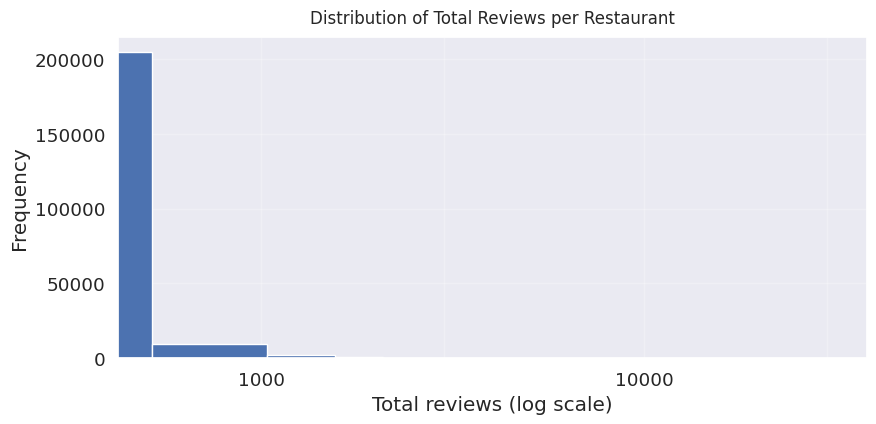

In [24]:
x = df["total_reviews_count"].dropna()
fig, ax = plt.subplots(figsize=(9, 4.5))
ax.hist(x, bins=60, edgecolor="white")
ax.set_xscale("log")
finalize_axes(ax, title="Distribution of Total Reviews per Restaurant",
              xlabel="Total reviews (log scale)", ylabel="Frequency")
ax.xaxis.set_major_locator(LogLocator(base=10, subs=(1.0, 3.0)))
ax.xaxis.set_major_formatter(LogFormatter(base=10))
plt.show()

###Key numeric heatmap

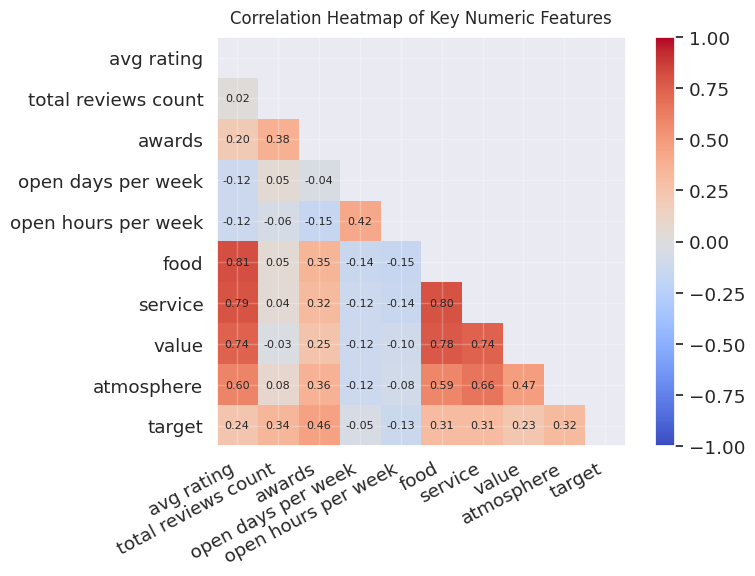

In [25]:
key_cols = [c for c in [
    "avg_rating","total_reviews_count","awards",
    "open_days_per_week","open_hours_per_week",
    "food","service","value","atmosphere","target"
] if c in df.columns]
cm = df[key_cols].corr().round(2).to_numpy()
labels = [nice_label(c) for c in key_cols]
mask = np.triu(np.ones_like(cm, dtype=bool))
cmasked = np.ma.array(cm, mask=mask)

fig, ax = plt.subplots(figsize=(8.5, 6))
im = ax.imshow(cmasked, vmin=-1, vmax=1, cmap="coolwarm")
plt.colorbar(im, fraction=0.046, pad=0.04)
ax.set_xticks(range(len(labels)))
ax.set_yticks(range(len(labels)))
ax.set_xticklabels(labels, rotation=28, ha="right")
ax.set_yticklabels(labels)
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        if not mask[i, j]:
            ax.text(j, i, f"{cm[i,j]:.2f}", ha="center", va="center", fontsize=8)
finalize_axes(ax, title="Correlation Heatmap of Key Numeric Features")
plt.show()

###Top 10 correlations heatmaps

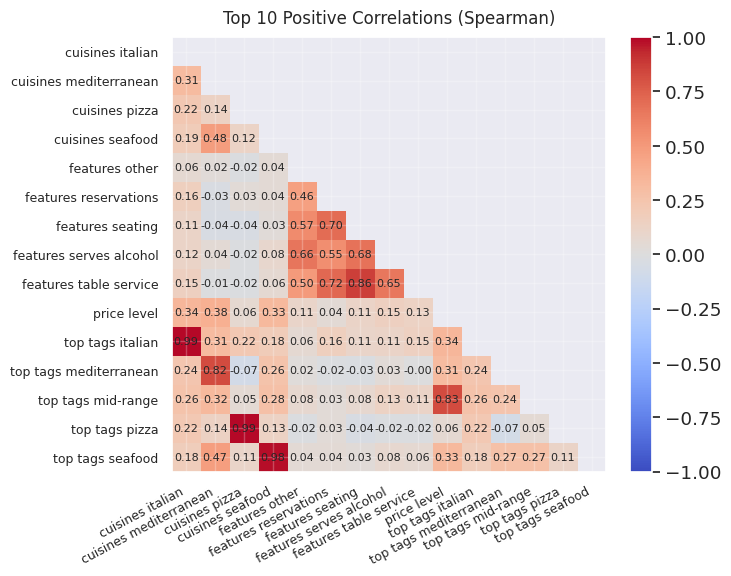

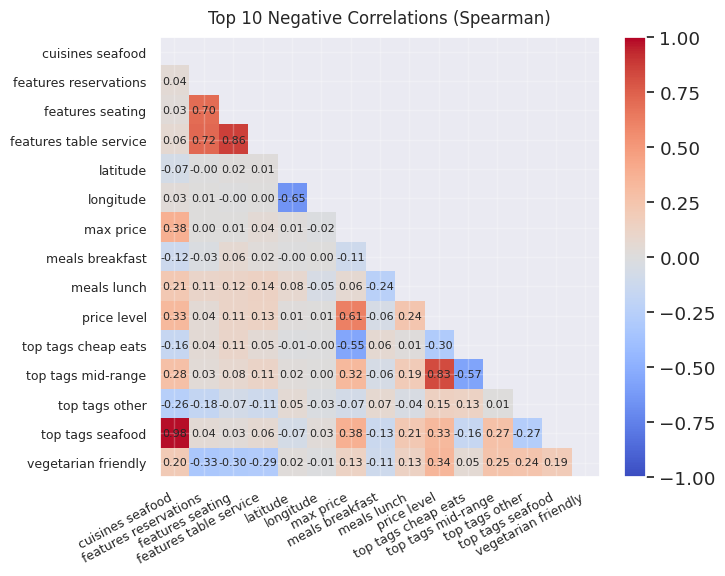

In [26]:
EXCLUDE_FOR_HEATMAP = rating_cols + exp_cols + ["avg_rating", "total_reviews_count"]
METHOD = "spearman"
TOP_PAIRS = 10
FIGSIZE = (7.5, 6)

num_cols = [c for c in df.select_dtypes(include=[np.number]).columns if c not in EXCLUDE_FOR_HEATMAP]
corr = df[num_cols].corr(method=METHOD).dropna(how="all").dropna(how="all", axis=1)

def plot_corr_heatmap(c: pd.DataFrame, title: str, figsize=FIGSIZE):
    m = c.to_numpy()
    labels = [nice_label(x) for x in c.columns]
    mask = np.triu(np.ones_like(m, dtype=bool))
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(np.ma.array(m, mask=mask), vmin=-1, vmax=1, cmap="coolwarm")
    plt.colorbar(im, fraction=0.046, pad=0.04)
    ax.set_xticks(range(len(labels)))
    ax.set_yticks(range(len(labels)))
    ax.set_xticklabels(labels, rotation=28, ha="right", fontsize=9)
    ax.set_yticklabels(labels, fontsize=9)
    for i in range(m.shape[0]):
        for j in range(m.shape[1]):
            if not mask[i, j]:
                ax.text(j, i, f"{m[i,j]:.2f}", ha="center", va="center", fontsize=8)
    finalize_axes(ax, title=title)

tri_mask = np.triu(np.ones_like(corr, dtype=bool), k=1)
pairs = corr.where(tri_mask).stack().rename("r").reset_index()
pairs.columns = ["col_i", "col_j", "r"]

top_pos = pairs.sort_values("r", ascending=False).head(TOP_PAIRS)
top_neg = pairs.sort_values("r", ascending=True).head(TOP_PAIRS)

pos_cols = sorted(set(top_pos["col_i"]).union(top_pos["col_j"]))
neg_cols = sorted(set(top_neg["col_i"]).union(top_neg["col_j"]))

plot_corr_heatmap(corr.loc[pos_cols, pos_cols], f"Top {TOP_PAIRS} Positive Correlations ({METHOD.title()})")
plt.savefig("pos_cols.png", dpi=300, bbox_inches="tight")
plot_corr_heatmap(corr.loc[neg_cols, neg_cols], f"Top {TOP_PAIRS} Negative Correlations ({METHOD.title()})")
plt.savefig("neg_cols.png", dpi=300, bbox_inches="tight")
plt.show()


In [27]:
# Also print highly correlated pairs (≥ 0.9)
hi = corr[corr.abs() > 0.9]
hi_pairs = [(i, j) for i in hi.columns for j in hi.index if i != j and abs(corr.loc[i, j]) > 0.9]
print("Highly correlated numeric pairs (|r| > 0.9):", hi_pairs)

Highly correlated numeric pairs (|r| > 0.9): [('cuisines__italian', 'top_tags__italian'), ('cuisines__pizza', 'top_tags__pizza'), ('cuisines__seafood', 'top_tags__seafood'), ('top_tags__italian', 'cuisines__italian'), ('top_tags__pizza', 'cuisines__pizza'), ('top_tags__seafood', 'cuisines__seafood')]


###Chi-square on region

In [28]:
table = pd.crosstab(df["target"], df["region"])
chi2, p, dof, expected = chi2_contingency(table)
print(f"Chi-square statistic: {chi2:.4f}, p-value: {p:.4e}, dof: {dof}")

Chi-square statistic: 382.3314, p-value: 1.4862e-82, dof: 3


###Simple logistic model

In [29]:
y = df["target"].astype(float)
X = df[["price_level", "is_michelin", "vegetarian_friendly", "vegan_options", "gluten_free"]].copy()
mask = X.notna().all(axis=1) & y.notna()
X = sm.add_constant(X[mask])
y = y[mask]
logit_model = sm.Logit(y, X).fit()
print(logit_model.summary())

Optimization terminated successfully.
         Current function value: 0.213438
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:                 target   No. Observations:               224763
Model:                          Logit   Df Residuals:                   224757
Method:                           MLE   Df Model:                            5
Date:                Tue, 11 Nov 2025   Pseudo R-squ.:                  0.2761
Time:                        16:19:13   Log-Likelihood:                -47973.
converged:                       True   LL-Null:                       -66273.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -4.3032      0.027   -162.028      0.000      -4.355      -4.251
pr

###Tests across categoricals

In [30]:
def test_target_by_categoricals(data: pd.DataFrame, target: str = "target",
                                max_levels_for_pairwise: int = 12, do_posthoc: bool = True, fdr_alpha: float = 0.05):
    results_bin, results_chi2, results_post = [], [], []
    cat_cols = ["region", "province", "city", "default_language"]
    if target in cat_cols:
        cat_cols.remove(target)
    for col in cat_cols:
        s = data[[col, target]].dropna()
        try:
            y = s[target].astype(float)
        except Exception:
            continue
        if not set(y.unique()).issubset({0.0, 1.0}):
            continue
        levels = s[col].astype(str)
        cats = levels.unique()
        k = len(cats)
        if k == 2:
            g1, g2 = cats[0], cats[1]
            n1 = (levels == g1).sum()
            n2 = (levels == g2).sum()
            x1 = y[levels == g1].sum()
            x2 = y[levels == g2].sum()
            stat, pval = proportions_ztest([x1, x2], [n1, n2])
            results_bin.append({
                "feature": col, "group1": g1, "n1": int(n1), "succ1": int(x1), "prop1": float(x1/n1) if n1 else np.nan,
                "group2": g2, "n2": int(n2), "succ2": int(x2), "prop2": float(x2/n2) if n2 else np.nan,
                "z_stat": float(stat), "p_value": float(pval)
            })
        elif k >= 3:
            tab = pd.crosstab(levels, y)
            chi2, pval, dof, exp = chi2_contingency(tab)
            results_chi2.append({
                "feature": col, "levels": k, "chi2": float(chi2), "dof": int(dof),
                "p_value": float(pval), "min_expected_cell": float(exp.min())
            })
            if do_posthoc and k <= max_levels_for_pairwise:
                lv = list(cats)
                pairs = []
                for i in range(len(lv)):
                    for j in range(i+1, len(lv)):
                        a, b = lv[i], lv[j]
                        n_a = (levels == a).sum()
                        n_b = (levels == b).sum()
                        x_a = y[levels == a].sum()
                        x_b = y[levels == b].sum()
                        if n_a == 0 or n_b == 0: continue
                        stat, p_pair = proportions_ztest([x_a, x_b], [n_a, n_b])
                        pairs.append((a, b, stat, p_pair, x_a/n_a if n_a else np.nan, x_b/n_b if n_b else np.nan))
                if pairs:
                    pvals = [p for *_ , p in pairs]
                    rej, p_adj, *_ = multipletests(pvals, alpha=fdr_alpha, method="fdr_bh")
                    for (a,b,stat,p_raw,pa,pb), r, padj in zip(pairs, rej, p_adj):
                        results_post.append({
                            "feature": col, "level_a": a, "level_b": b, "prop_a": pa, "prop_b": pb,
                            "z_stat": float(stat), "p_raw": float(p_raw), "p_fdr_bh": float(padj), "reject_fdr": bool(r)
                        })
    bin_df  = pd.DataFrame(results_bin).sort_values("p_value") if results_bin else pd.DataFrame()
    chi2_df = pd.DataFrame(results_chi2).sort_values("p_value") if results_chi2 else pd.DataFrame()
    post_df = pd.DataFrame(results_post).sort_values("p_fdr_bh") if results_post else pd.DataFrame()
    return bin_df, chi2_df, post_df

bin_tests, chi2_tests, posthoc = test_target_by_categoricals(df)
display(bin_tests.head(10), chi2_tests.head(10), posthoc.head(10))
plt.show()

,feature,group1,n1,succ1,prop1,group2,n2,succ2,prop2,z_stat,p_value
0,default_language,All languages,95974,902,0.009398,English,112399,18587,0.165366,-121.876927,0.0


,feature,levels,chi2,dof,p_value,min_expected_cell
2,city,40,1294.746844,39,2.662996e-246,18.295623
1,province,38,956.898808,37,8.905376e-177,10.578512
0,region,4,382.331389,3,1.486228e-82,1961.360099


,feature,level_a,level_b,prop_a,prop_b,z_stat,p_raw,p_fdr_bh,reject_fdr
0,region,North,South,0.075948,0.087525,-7.225347,4.998253e-13,0.10417,False
1,region,North,Islands,0.075948,0.090981,-7.624922,2.441826e-14,0.10417,False
2,region,North,Center,0.075948,0.104170,-19.458309,2.478289e-84,0.10417,False
3,region,South,Islands,0.087525,0.090981,-1.452231,1.464374e-01,0.10417,False
4,region,South,Center,0.087525,0.104170,-8.546299,1.270980e-17,0.10417,False
5,region,Islands,Center,0.090981,0.104170,-5.593164,2.229680e-08,0.10417,False


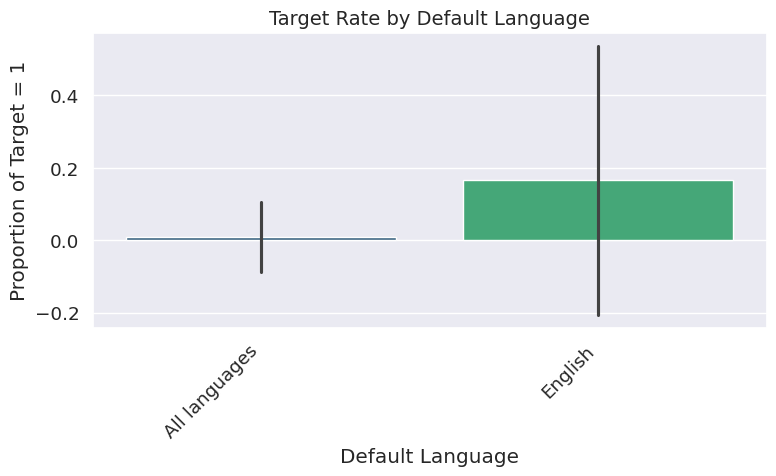

In [31]:
plt.figure(figsize=(8,5))
sns.barplot(
    data=df,
    x="default_language",
    y="target",
    estimator="mean",
    errorbar="sd",
    palette="viridis"
)
plt.title("Target Rate by Default Language", fontsize=14)
plt.ylabel("Proportion of Target = 1")
plt.xlabel("Default Language")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.savefig("Target_Rate_by_Default_Language.png", dpi=300, bbox_inches="tight")
plt.show()


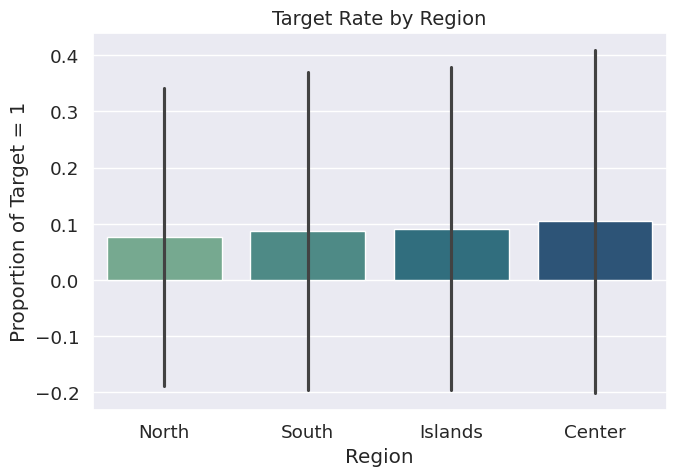

In [32]:
plt.figure(figsize=(7,5))
sns.barplot(
    data=df,
    x="region",
    y="target",
    estimator="mean",
    errorbar="sd",
    palette="crest"
)
plt.title("Target Rate by Region", fontsize=14)
plt.ylabel("Proportion of Target = 1")
plt.xlabel("Region")
plt.tight_layout()
plt.show()

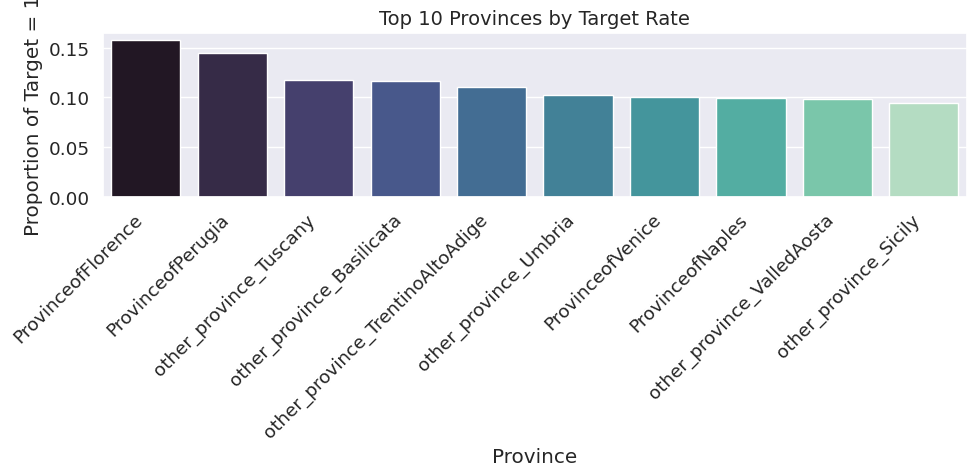

In [33]:
# Top 10 provinces by success rate
top_prov = (
    df.groupby("province")["target"]
    .mean()
    .sort_values(ascending=False)
    .head(10)
    .reset_index()
)

plt.figure(figsize=(10,5))
sns.barplot(
    data=top_prov,
    x="province",
    y="target",
    palette="mako"
)
plt.title("Top 10 Provinces by Target Rate", fontsize=14)
plt.ylabel("Proportion of Target = 1")
plt.xlabel("Province")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

Default language shows the largest effect by far. English-language visibility correlates with success.

Geographic features (region, province, city) are all highly significant — strong spatial differences exist.

Center region tends to outperform others in raw proportions.

###Simple binary z-tests plots

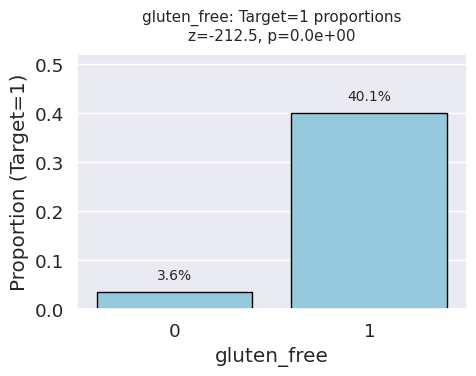

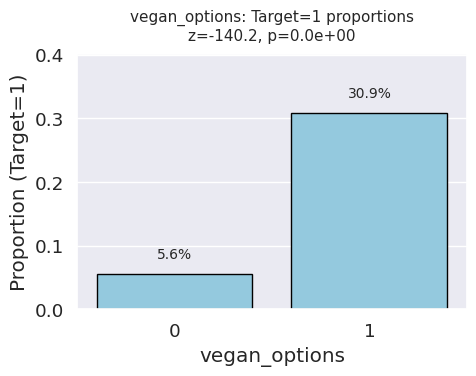

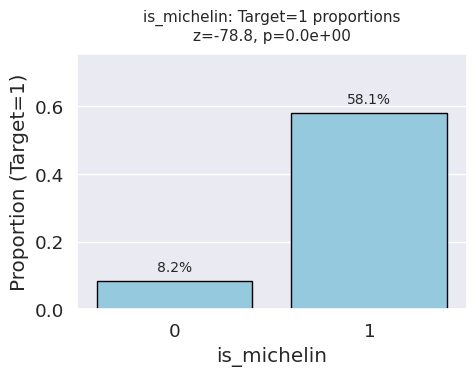

In [34]:
def ztest_binary(data: pd.DataFrame, target="target", predictor="is_michelin", positive=1):
    tmp = data[[target, predictor]].dropna().copy()
    tmp[target] = tmp[target].astype(float)
    tmp[predictor] = tmp[predictor].astype(str)
    levels = tmp[predictor].unique()
    if len(levels) != 2:
        raise ValueError(f"'{predictor}' must be binary; found {len(levels)} levels: {levels}")
    g1, g2 = levels
    n1 = (tmp[predictor] == g1).sum()
    n2 = (tmp[predictor] == g2).sum()
    x1 = tmp.loc[tmp[predictor] == g1, target].eq(positive).sum()
    x2 = tmp.loc[tmp[predictor] == g2, target].eq(positive).sum()
    stat, pval = proportions_ztest([x1, x2], [n1, n2])

    plot_df = pd.DataFrame({predictor: [g1, g2],
                            "prop_target_1": [x1/n1 if n1 else np.nan, x2/n2 if n2 else np.nan]})
    plt.figure(figsize=(5,4))
    sns.barplot(data=plot_df, x=predictor, y="prop_target_1", color="skyblue", edgecolor="black")
    plt.title(f"{predictor}: Target=1 proportions\nz={stat:.1f}, p={pval:.1e}", fontsize=11, pad=10)
    plt.ylabel("Proportion (Target=1)")
    plt.xlabel(predictor)
    for i, v in enumerate(plot_df["prop_target_1"]):
        plt.text(i, v + 0.02, f"{v:.1%}", ha="center", va="bottom", fontsize=10)
    plt.ylim(0, min(1, plot_df["prop_target_1"].max()*1.3))
    plt.tight_layout()
    plt.show()

    return {"predictor": predictor, "z_stat": float(stat), "p_value": float(pval)}

z_gluten = ztest_binary(df, target="target", predictor="gluten_free")
z_vegan  = ztest_binary(df, target="target", predictor="vegan_options")
z_mich   = ztest_binary(df, target="target", predictor="is_michelin")
plt.show()



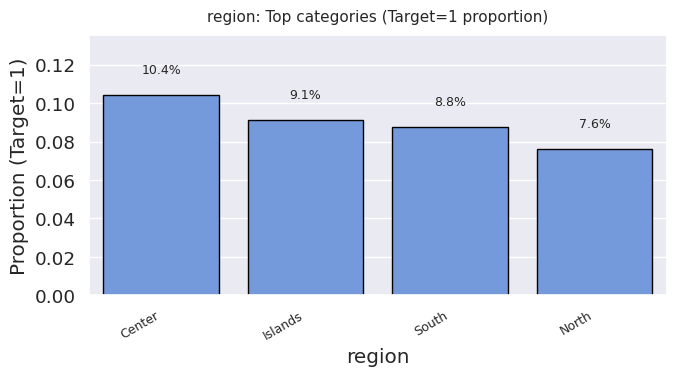

In [35]:

def chi_square_plot(data: pd.DataFrame, target="target", predictor="region", top_k_plot=10):
    tmp = data[[target, predictor]].dropna().copy()
    tmp[target] = tmp[target].astype(float)
    tmp[predictor] = tmp[predictor].astype(str)
    tab = pd.crosstab(tmp[predictor], tmp[target])
    prop1 = tab.get(1.0, pd.Series(0, index=tab.index)) / tab.sum(axis=1)
    top_levels = prop1.sort_values(ascending=False).head(top_k_plot)
    plt.figure(figsize=(7,4))
    sns.barplot(x=top_levels.index, y=top_levels.values, color="cornflowerblue", edgecolor="black")
    plt.title(f"{predictor}: Top categories (Target=1 proportion)", fontsize=11, pad=10)
    plt.ylabel("Proportion (Target=1)")
    plt.xlabel(predictor)
    plt.xticks(rotation=30, ha="right", fontsize=9)
    for i, v in enumerate(top_levels.values):
        plt.text(i, v + 0.01, f"{v:.1%}", ha="center", va="bottom", fontsize=9)
    plt.ylim(0, min(1, top_levels.max()*1.3))
    plt.tight_layout()
    plt.savefig("Region_chi_square.png", dpi=300, bbox_inches="tight")
    plt.show()

chi_square_plot(df, predictor="region")
plt.show()


In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 224763 entries, 0 to 224762
Data columns (total 63 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   restaurant_link                    224763 non-null  string 
 1   restaurant_name                    224763 non-null  string 
 2   region                             224763 non-null  string 
 3   province                           224763 non-null  string 
 4   city                               224763 non-null  string 
 5   address                            224763 non-null  string 
 6   latitude                           222603 non-null  float64
 7   longitude                          222603 non-null  float64
 8   claimed                            224763 non-null  int64  
 9   awards                             224763 non-null  int64  
 10  popularity_detailed                208339 non-null  string 
 11  popularity_generic                 2074

In [37]:
# Save
with open("df_after_eda.pkl", "wb") as f:
    pickle.dump(df, f)


##Conclusions


*   Rating-related columns (excellent, food, service, etc.) were dropped to prevent target leakage.

*   Strong positive association between English default language and restaurant success → international visibility matters.


*   Significant geographic effects found: Center region shows the highest target rate. Provinces differ widely, suggesting regional business or tourism dynamics.
*   Highly correlated duplicates (e.g., cuisines__italian ↔ top_tags__italian) removed to reduce redundancy.


*   Some numeric features are skewed
